In [1]:
import json, math, os, re, requests, time

import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.pylab as plt

from tqdm.notebook import tqdm
from sklearn.preprocessing import MultiLabelBinarizer

pd.set_option('display.max_columns', 100)
import warnings
warnings.filterwarnings("ignore")


In C:\Users\User\Anaconda3\lib\site-packages\matplotlib\mpl-data\stylelib\_classic_test.mplstyle: 
The text.latex.preview rcparam was deprecated in Matplotlib 3.3 and will be removed two minor releases later.
In C:\Users\User\Anaconda3\lib\site-packages\matplotlib\mpl-data\stylelib\_classic_test.mplstyle: 
The mathtext.fallback_to_cm rcparam was deprecated in Matplotlib 3.3 and will be removed two minor releases later.
In C:\Users\User\Anaconda3\lib\site-packages\matplotlib\mpl-data\stylelib\_classic_test.mplstyle: Support for setting the 'mathtext.fallback_to_cm' rcParam is deprecated since 3.3 and will be removed two minor releases later; use 'mathtext.fallback : 'cm' instead.
In C:\Users\User\Anaconda3\lib\site-packages\matplotlib\mpl-data\stylelib\_classic_test.mplstyle: 
The validate_bool_maybe_none function was deprecated in Matplotlib 3.3 and will be removed two minor releases later.
In C:\Users\User\Anaconda3\lib\site-packages\matplotlib\mpl-data\stylelib\_classic_test.mplstyle

In [2]:
os.chdir('C:/Users/User/Desktop/NOTES/Notes_Y4S2/BT4222/HDB Project/Final Merge of Data/')

In [3]:
[item for item in os.listdir() if '.csv' in item or '.xlsx' in item or '.kml' in item]

['average_cases_by_npc.csv',
 'Completion_Date_Manual_Fill.csv',
 'crime cases_dataset.csv',
 'final_dataset.csv',
 'general-information-of-schools.csv',
 'hdb_dataset.csv',
 'lrt_openingDates.xlsx',
 'mrtsg.csv',
 'police centre_dataset.xlsx',
 'police_centre_gdf.csv',
 'preliminary_dataset.csv',
 'primary_sch_gdf.csv',
 'priSch_openingDates.csv',
 'property_price_index.csv',
 'train_gdf.csv',
 'train_stations_data.csv']

In [4]:
# Remove duplicate rows
def remove_duplicates(data):
    data.drop_duplicates(inplace=True)
    data.reset_index(drop=True, inplace=True)
    
    return data

<AxesSubplot:xlabel='Area (SQM)', ylabel='Density'>

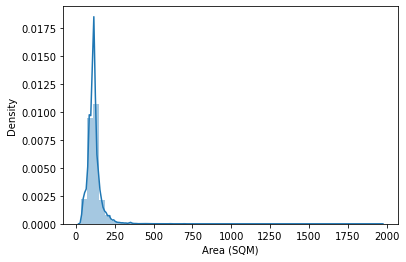

In [5]:
df_o = pd.read_csv('final_dataset.csv')
sns.distplot(df_o["Area (SQM)"])

<AxesSubplot:xlabel='Unit Price ($ PSM)'>

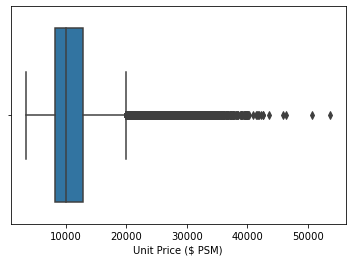

In [6]:
sns.boxplot(x=df_o["Unit Price ($ PSM)"])

In [7]:
df = pd.read_csv('final_dataset.csv')

In [8]:
df.shape

(54754, 66)

In [9]:
df.head(3)

,Transacted Price ($),Sale Date,Area (SQM),Unit Price ($ PSM),Property Type,Postal Code,Planning Region,Planning Area,Floor Number,BLK_NO,ROAD_NAME,BUILDING,POSTAL,PPI,Police Centre,Average Cases Per Year,Number of Primary Schools,Nearest Primary School,num_stations_1km,nearest_station_distance,Remaining Lease,Age Sold,Ang Mo Kio,Bedok,Bishan,Bukit Batok,Bukit Merah,Bukit Panjang,Bukit Timah,Choa Chu Kang,Clementi,Downtown Core,Geylang,Hougang,Jurong East,Jurong West,Kallang,Mandai,Marine Parade,Museum,Newton,Novena,Orchard,Outram,Pasir Ris,Punggol,Queenstown,River Valley,Rochor,Sembawang,Sengkang,Serangoon,Singapore River,Southern Islands,Tampines,Tanglin,Toa Payoh,Woodlands,Yishun,BLUE,BROWN,GREEN,LRT,PURPLE,RED,YELLOW
0,"600,000",2010-01-01,95.0,6316.0,Condominium,759151,North Region,Mandai,1.0,5,JALAN MATA AYER,EUPHONY GARDENS,759151,124.3,Yishun South NPC,33,7,705.752731,0,1207.822015,87.0,9.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,"1,909,000",2010-01-02,138.0,13833.0,Condominium,98656,Central Region,Bukit Merah,1.0,42,KEPPEL BAY DRIVE,CARIBBEAN AT KEPPEL BAY,98656,124.3,Bukit Merah West NPC,58,3,1233.947139,1,768.529003,88.0,6.0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
2,"890,000",2010-01-03,99.0,8990.0,Condominium,597592,Central Region,Bukit Timah,10.0,7,PINE GROVE,ASTOR GREEN,597592,124.3,Clementi NPC,50,4,1039.586179,1,816.818037,80.0,15.0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0


In [10]:
duplicate = df[df.duplicated()] 
duplicate.head()

,Transacted Price ($),Sale Date,Area (SQM),Unit Price ($ PSM),Property Type,Postal Code,Planning Region,Planning Area,Floor Number,BLK_NO,ROAD_NAME,BUILDING,POSTAL,PPI,Police Centre,Average Cases Per Year,Number of Primary Schools,Nearest Primary School,num_stations_1km,nearest_station_distance,Remaining Lease,Age Sold,Ang Mo Kio,Bedok,Bishan,Bukit Batok,Bukit Merah,Bukit Panjang,Bukit Timah,Choa Chu Kang,Clementi,Downtown Core,Geylang,Hougang,Jurong East,Jurong West,Kallang,Mandai,Marine Parade,Museum,Newton,Novena,Orchard,Outram,Pasir Ris,Punggol,Queenstown,River Valley,Rochor,Sembawang,Sengkang,Serangoon,Singapore River,Southern Islands,Tampines,Tanglin,Toa Payoh,Woodlands,Yishun,BLUE,BROWN,GREEN,LRT,PURPLE,RED,YELLOW
2296,"750,000",2010-04-05,109.0,6881.0,Apartment,59108,Central Region,Outram,31.0,1,PARK ROAD,PEOPLE'S PARK COMPLEX,59108,130.5,Bukit Merah East NPC,85,4,1005.686716,5,96.914452,57.0,38.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,1,0
2302,"750,000",2010-04-05,109.0,6881.0,Apartment,59108,Central Region,Outram,31.0,1,PARK ROAD,PEOPLE'S PARK COMPLEX,59108,130.5,Bukit Merah East NPC,85,4,1005.686716,5,96.914452,57.0,38.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,1,0
2308,"750,000",2010-04-05,109.0,6881.0,Apartment,59108,Central Region,Outram,31.0,1,PARK ROAD,PEOPLE'S PARK COMPLEX,59108,130.5,Bukit Merah East NPC,85,4,1005.686716,5,96.914452,57.0,38.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,1,0
4021,"770,000",2010-06-02,109.0,7064.0,Apartment,59108,Central Region,Outram,31.0,1,PARK ROAD,PEOPLE'S PARK COMPLEX,59108,130.5,Bukit Merah East NPC,85,4,1005.686716,5,96.914452,57.0,38.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,1,0
4030,"770,000",2010-06-02,109.0,7064.0,Apartment,59108,Central Region,Outram,31.0,1,PARK ROAD,PEOPLE'S PARK COMPLEX,59108,130.5,Bukit Merah East NPC,85,4,1005.686716,5,96.914452,57.0,38.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,1,0


In [11]:
df.drop(columns = ['PPI', 'Police Centre', 'Average Cases Per Year',
                   'Ang Mo Kio',
       'Bedok', 'Bishan', 'Bukit Batok', 'Bukit Merah', 'Bukit Panjang',
       'Bukit Timah', 'Choa Chu Kang', 'Clementi', 'Downtown Core', 'Geylang',
       'Hougang', 'Jurong East', 'Jurong West', 'Kallang', 'Mandai',
       'Marine Parade', 'Museum', 'Newton', 'Novena', 'Orchard', 'Outram',
       'Pasir Ris', 'Punggol', 'Queenstown', 'River Valley', 'Rochor',
       'Sembawang', 'Sengkang', 'Serangoon', 'Singapore River', 'Tampines',
       'Tanglin', 'Toa Payoh', 'Woodlands', 'Yishun', 'BLUE', 'GREEN', 'LRT',
       'PURPLE', 'RED', 'YELLOW'], inplace = True)

In [12]:
df['Transacted Price ($)'] = df['Transacted Price ($)'].replace(',', '', regex=True).astype(float)

In [13]:
central = df[df['Planning Region'] == 'Central Region']
east = df[df['Planning Region'] == 'East Region']
northea = df[df['Planning Region'] == 'North East Region']
north = df[df['Planning Region'] == 'North Region']
west = df[df['Planning Region'] == 'West Region']

In [14]:
df.groupby(['Planning Region']).size()

Planning Region
Central Region       18660
East Region          12340
North East Region     9136
North Region          4391
West Region          10227
dtype: int64

## Primary School

#### Hypotheses: 
##### 1. The more schools within 2km radius to the property, the more expensive the property.
##### 2. The smaller the distance of the nearest school to the property, the more expensive the property. 
##### 3. The smaller the distance of the nearest train station to the property, the more expensive the property.

### Number of Primary Schools

In [15]:
import plotly.express as px

<AxesSubplot:xlabel='Number of Primary Schools', ylabel='Density'>

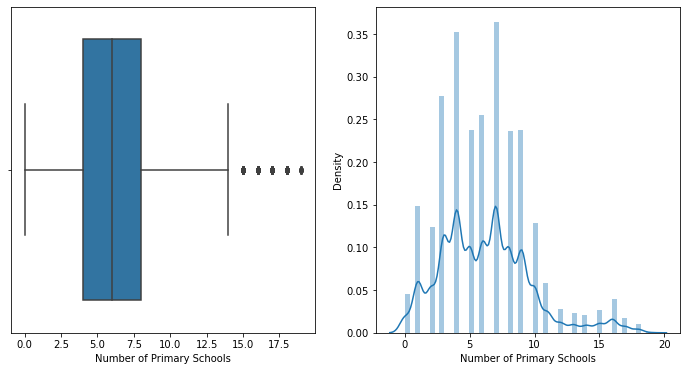

In [16]:
fig, (ax1, ax2) = plt.subplots(figsize=(12, 6), ncols=2, sharex=False, sharey=False)
sns.boxplot(x=df["Number of Primary Schools"], ax=ax1)
sns.distplot(df["Number of Primary Schools"], ax=ax2)

<AxesSubplot:xlabel='Number of Primary Schools', ylabel='Planning Region'>

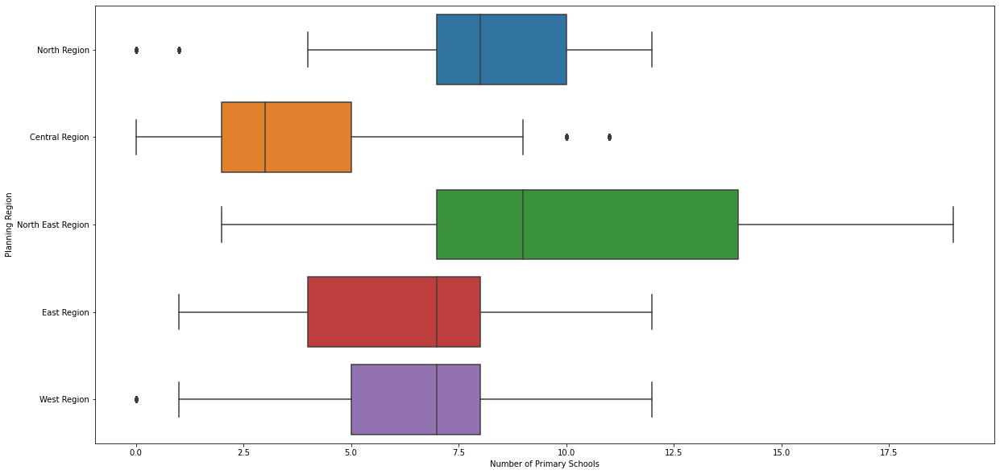

In [17]:
plt.figure(figsize=(20,10))
sns.boxplot(x="Number of Primary Schools", y="Planning Region", data=df)

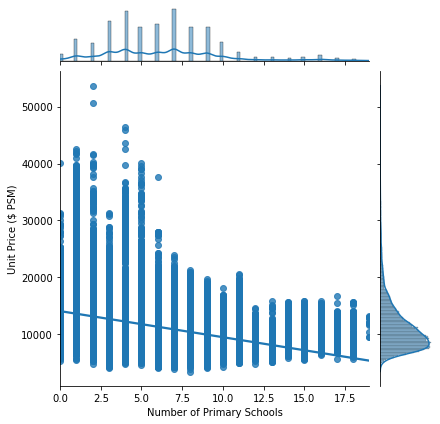

In [18]:
sns.jointplot(x="Number of Primary Schools", y="Unit Price ($ PSM)", data=df, kind = 'reg')

<AxesSubplot:xlabel='Number of Primary Schools', ylabel='Unit Price ($ PSM)'>

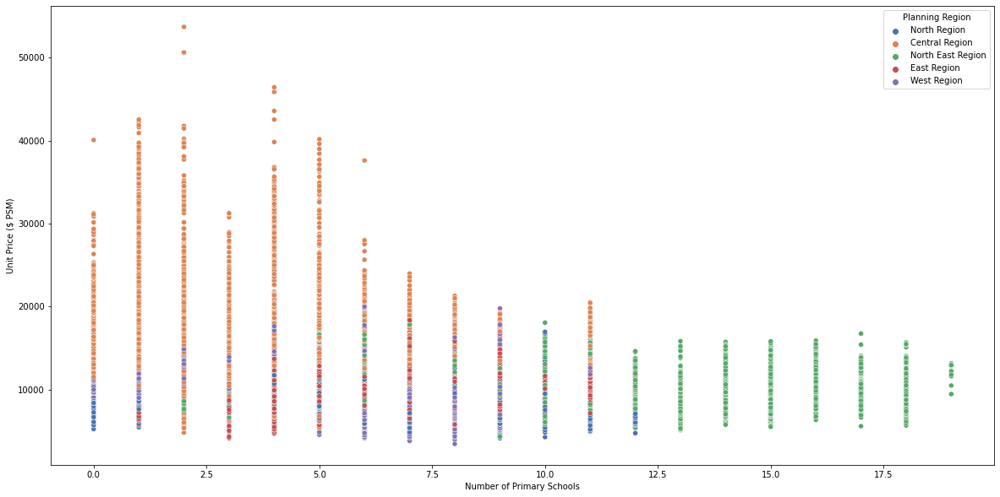

In [19]:
plt.figure(figsize=(20,10))
sns.scatterplot(data=df, x="Number of Primary Schools", y="Unit Price ($ PSM)", hue="Planning Region", palette="deep")

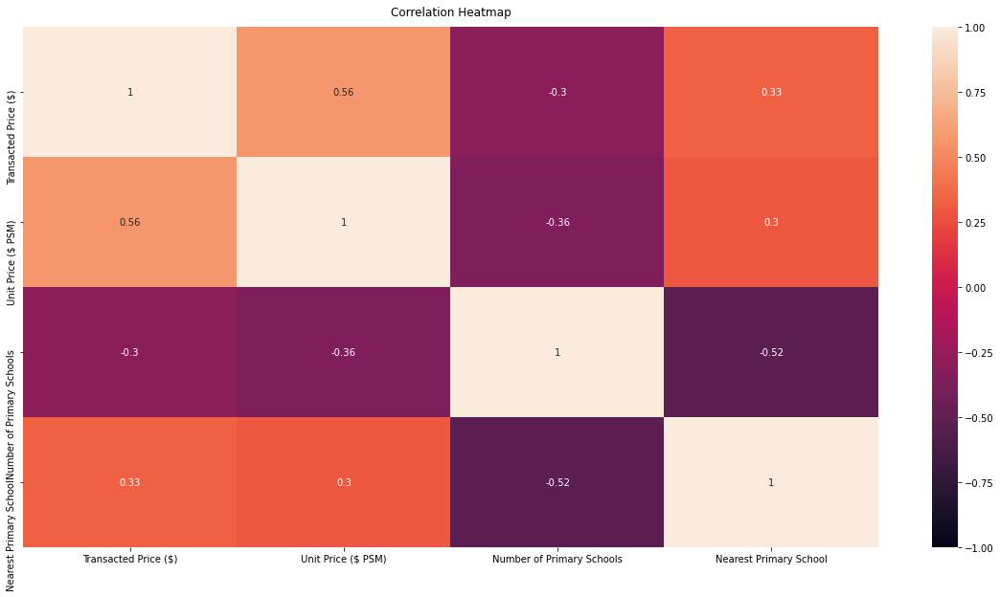

In [20]:
plt.figure(figsize=(20, 10))
heatmap = sns.heatmap(df[['Transacted Price ($)', 'Unit Price ($ PSM)', 'Number of Primary Schools', 'Nearest Primary School']].corr(), vmin=-1, vmax=1, annot=True)
heatmap.set_title('Correlation Heatmap', fontdict={'fontsize':12}, pad=12);

##### Central

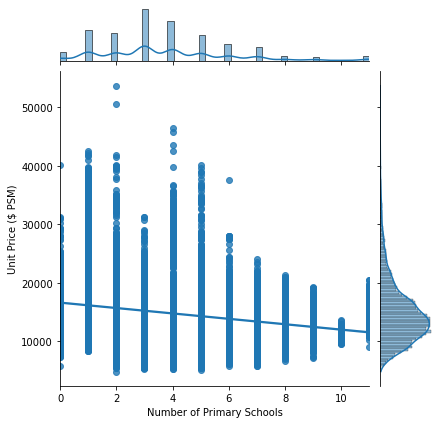

In [21]:
sns.jointplot(x="Number of Primary Schools", y="Unit Price ($ PSM)", data=central, kind = 'reg')

##### Northeast

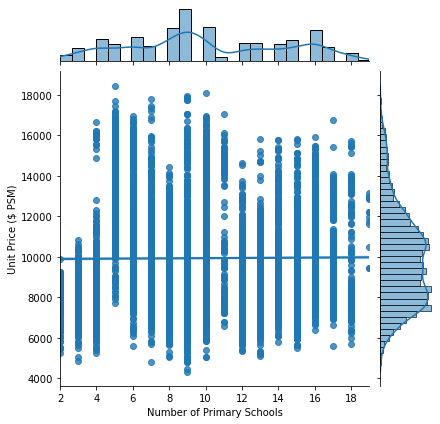

In [22]:
sns.jointplot(x="Number of Primary Schools", y="Unit Price ($ PSM)", data=northea, kind = 'reg')

##### East

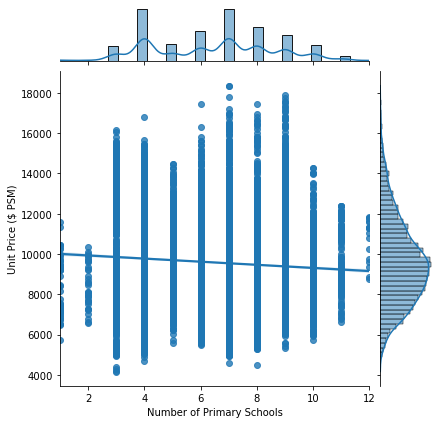

In [23]:
sns.jointplot(x="Number of Primary Schools", y="Unit Price ($ PSM)", data=east, kind = 'reg')

##### North

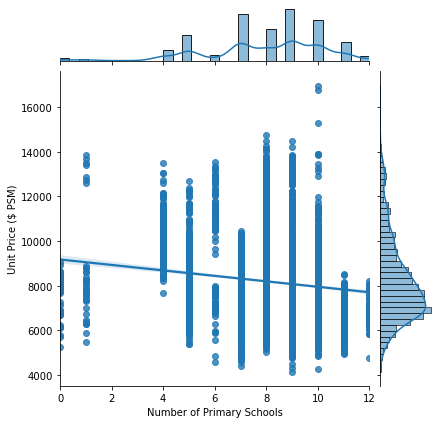

In [24]:
sns.jointplot(x="Number of Primary Schools", y="Unit Price ($ PSM)", data=north, kind = 'reg')

##### West

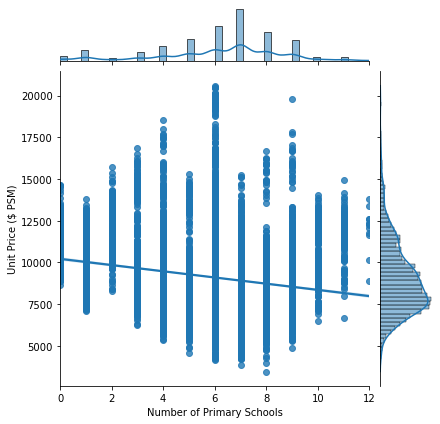

In [25]:
sns.jointplot(x="Number of Primary Schools", y="Unit Price ($ PSM)", data=west, kind = 'reg')

#### Transacted Price

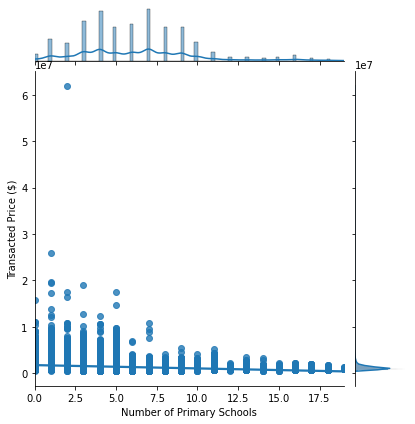

In [26]:
sns.jointplot(x="Number of Primary Schools", y="Transacted Price ($)", data=df, kind = 'reg')

In [27]:
df.dtypes

Transacted Price ($)         float64
Sale Date                     object
Area (SQM)                   float64
Unit Price ($ PSM)           float64
Property Type                 object
Postal Code                    int64
Planning Region               object
Planning Area                 object
Floor Number                 float64
BLK_NO                        object
ROAD_NAME                     object
BUILDING                      object
POSTAL                         int64
Number of Primary Schools      int64
Nearest Primary School       float64
num_stations_1km               int64
nearest_station_distance     float64
Remaining Lease              float64
Age Sold                     float64
Southern Islands               int64
BROWN                          int64
dtype: object

<AxesSubplot:xlabel='Number of Primary Schools', ylabel='Transacted Price ($)'>

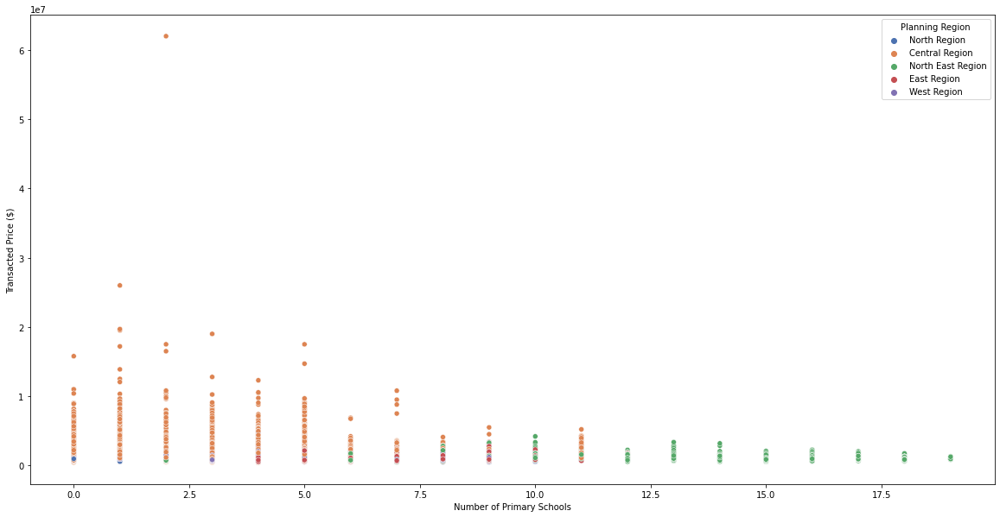

In [28]:
plt.figure(figsize=(20,10))
sns.scatterplot(data=df, x="Number of Primary Schools", y="Transacted Price ($)", hue="Planning Region", palette="deep")

##### Central

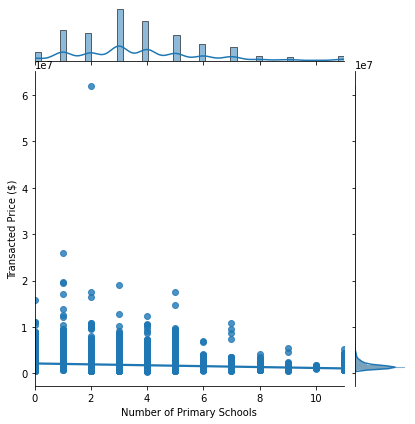

In [29]:
sns.jointplot(x="Number of Primary Schools", y="Transacted Price ($)", data=central, kind = 'reg')

##### Northeast

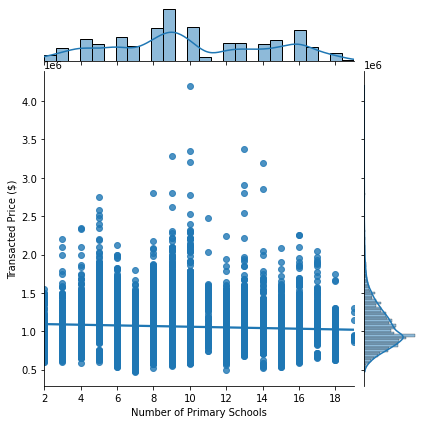

In [30]:
sns.jointplot(x="Number of Primary Schools", y="Transacted Price ($)", data=northea, kind = 'reg')

##### East

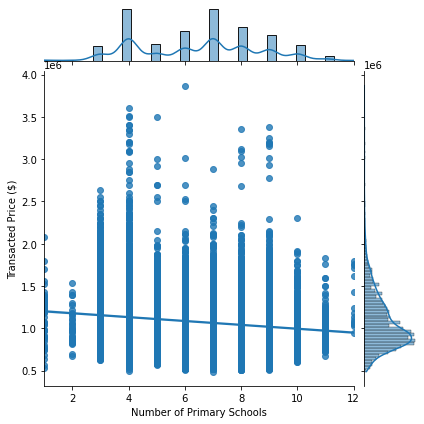

In [31]:
sns.jointplot(x="Number of Primary Schools", y="Transacted Price ($)", data=east, kind = 'reg')

##### North

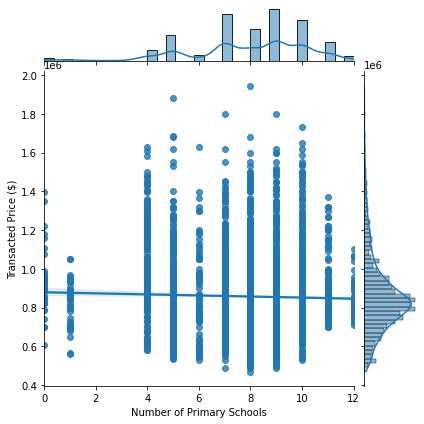

In [32]:
sns.jointplot(x="Number of Primary Schools", y="Transacted Price ($)", data=north, kind = 'reg')

##### West

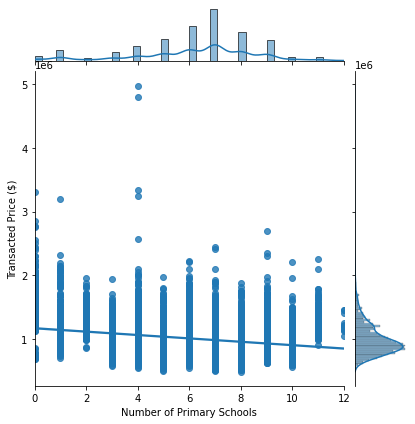

In [33]:
sns.jointplot(x="Number of Primary Schools", y="Transacted Price ($)", data=west, kind = 'reg')

#### Conclusion: The more primary schools within 2km, the lower the price of the property. Thus, hypothesis 1 is rejected

### Nearest Primary School

<AxesSubplot:xlabel='Nearest Primary School', ylabel='Density'>

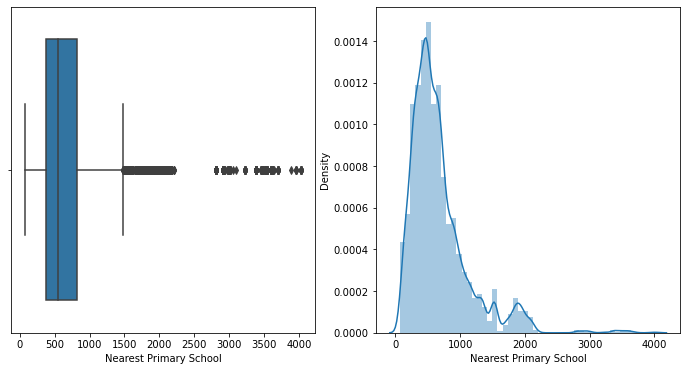

In [34]:
fig, (ax1, ax2) = plt.subplots(figsize=(12, 6), ncols=2, sharex=False, sharey=False)
sns.boxplot(x=df["Nearest Primary School"], ax=ax1)
sns.distplot(df["Nearest Primary School"], ax=ax2)

<AxesSubplot:xlabel='Nearest Primary School', ylabel='Planning Region'>

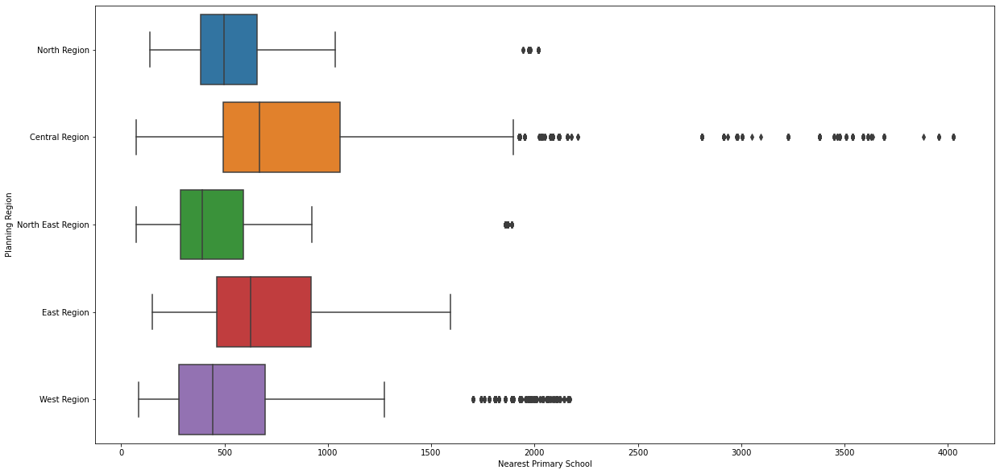

In [35]:
plt.figure(figsize=(20,10))
sns.boxplot(x="Nearest Primary School", y="Planning Region", data=df)

<AxesSubplot:xlabel='Unit Price ($ PSM)', ylabel='Planning Region'>

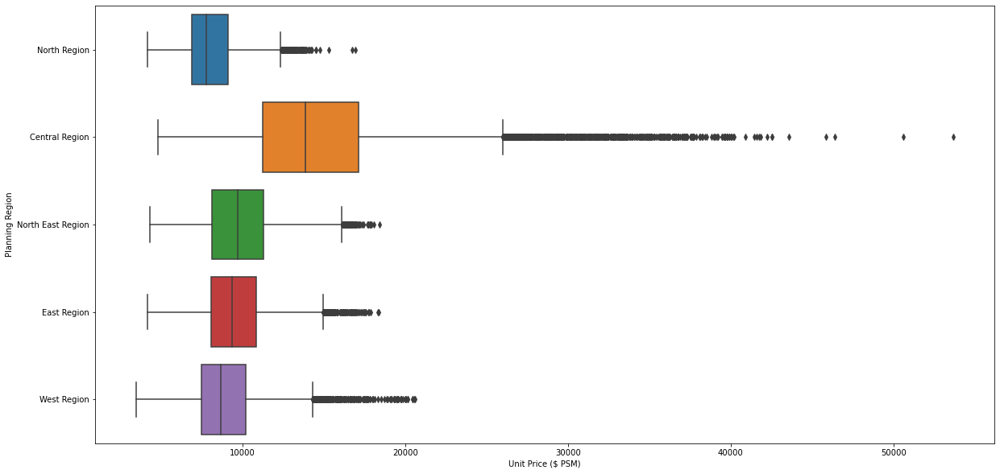

In [36]:
plt.figure(figsize=(20,10))
sns.boxplot(x="Unit Price ($ PSM)", y="Planning Region", data=df)

##### Nearest Primary School vs. Price

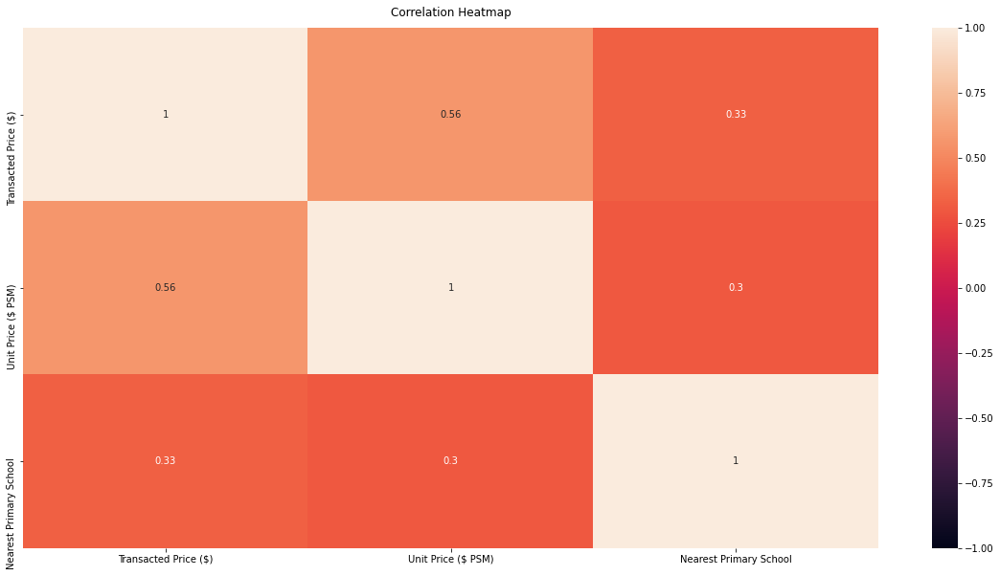

In [37]:
plt.figure(figsize=(20, 10))
heatmap = sns.heatmap(df[['Transacted Price ($)', 'Unit Price ($ PSM)', 'Nearest Primary School']].corr(), vmin=-1, vmax=1, annot=True)
heatmap.set_title('Correlation Heatmap', fontdict={'fontsize':12}, pad=12);

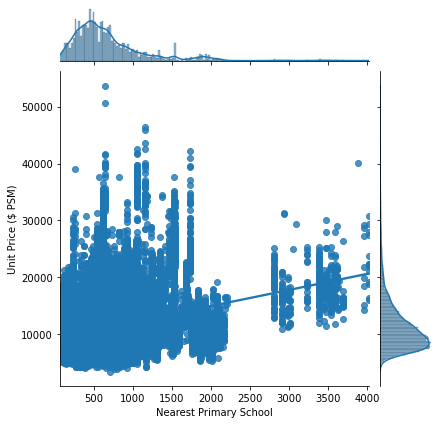

In [38]:
sns.jointplot(x="Nearest Primary School", y="Unit Price ($ PSM)", data=df, kind = 'reg')

#### Plotly express used for this plot, thus need to run notebook to see output.

In [39]:
fig = px.scatter(df, x="Nearest Primary School", y="Unit Price ($ PSM)", marginal_y="violin",
           marginal_x="box", trendline="ols", template="simple_white", 
                 title = "Unit Price Per Area Against Distance To Nearest Primary School", 
                labels={
                     "Nearest Primary School": "Nearest Primary School (m)"})

fig.update_traces(marker_color='#B279A2')
fig.show()

<AxesSubplot:xlabel='Nearest Primary School', ylabel='Unit Price ($ PSM)'>

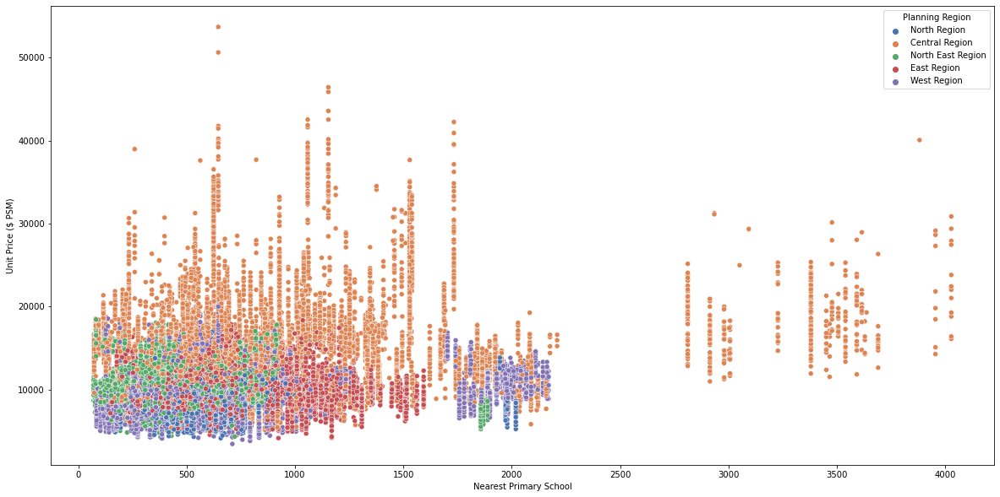

In [40]:
plt.figure(figsize=(20,10))
sns.scatterplot(data=df, x="Nearest Primary School", y="Unit Price ($ PSM)", hue="Planning Region", palette="deep")

##### Central

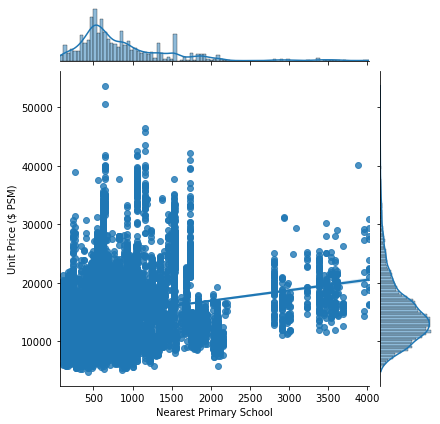

In [41]:
sns.jointplot(x="Nearest Primary School", y="Unit Price ($ PSM)", data=central, kind = 'reg')

##### Northeast

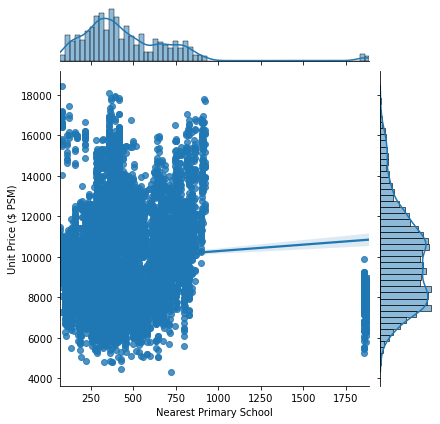

In [42]:
sns.jointplot(x="Nearest Primary School", y="Unit Price ($ PSM)", data=northea, kind = 'reg')

##### East

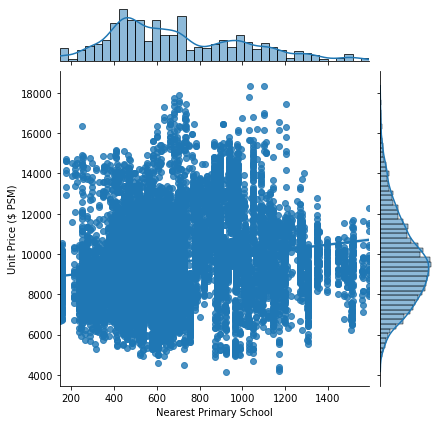

In [43]:
sns.jointplot(x="Nearest Primary School", y="Unit Price ($ PSM)", data=east, kind = 'reg')

##### North

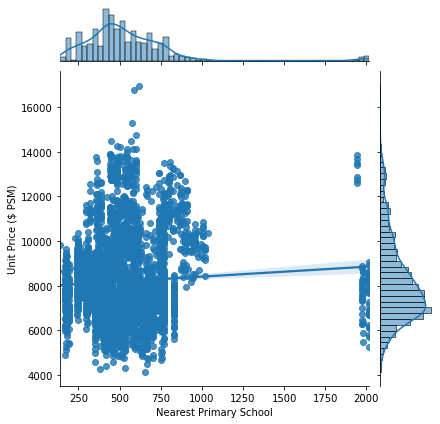

In [44]:
sns.jointplot(x="Nearest Primary School", y="Unit Price ($ PSM)", data=north, kind = 'reg')

##### West

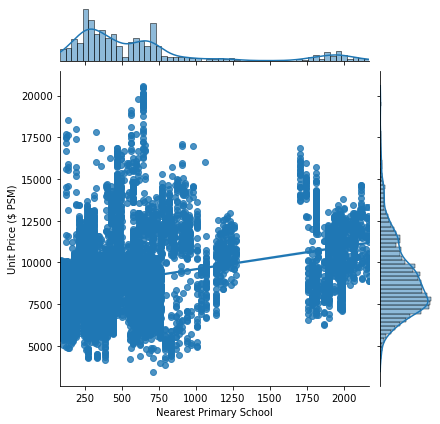

In [45]:
sns.jointplot(x="Nearest Primary School", y="Unit Price ($ PSM)", data=west, kind = 'reg')

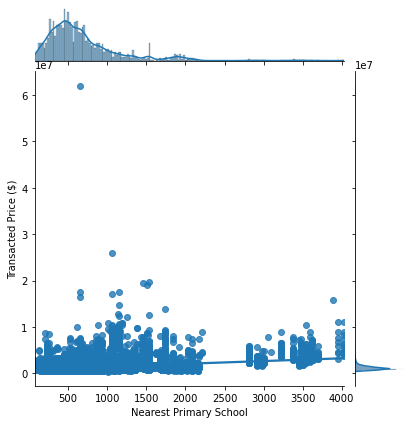

In [46]:
sns.jointplot(x="Nearest Primary School", y="Transacted Price ($)", data=df, kind = 'reg')

<AxesSubplot:xlabel='Nearest Primary School', ylabel='Transacted Price ($)'>

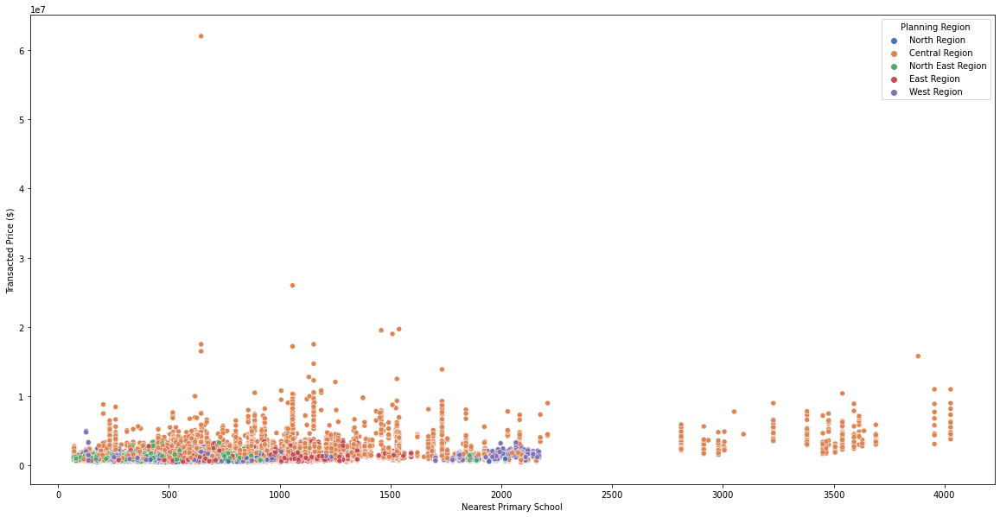

In [47]:
plt.figure(figsize=(20,10))
sns.scatterplot(data=df, x="Nearest Primary School", y="Transacted Price ($)", hue="Planning Region", palette="deep")

##### Central

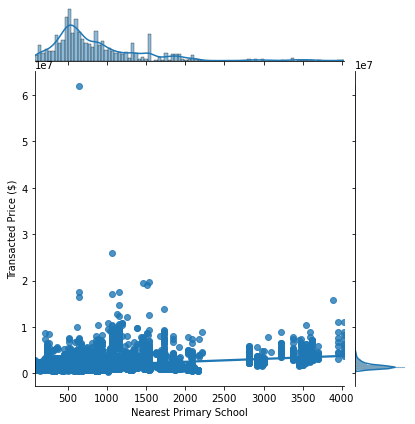

In [48]:
sns.jointplot(x="Nearest Primary School", y="Transacted Price ($)", data=central, kind = 'reg')

##### Northeast

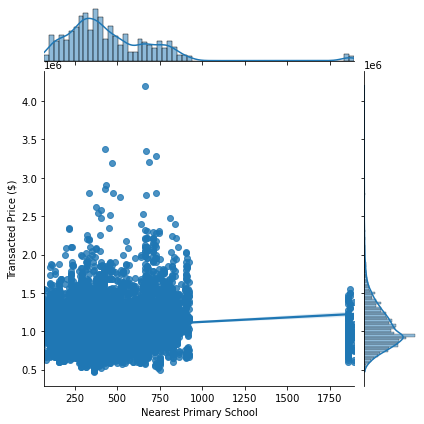

In [49]:
sns.jointplot(x="Nearest Primary School", y="Transacted Price ($)", data=northea, kind = 'reg')

##### East

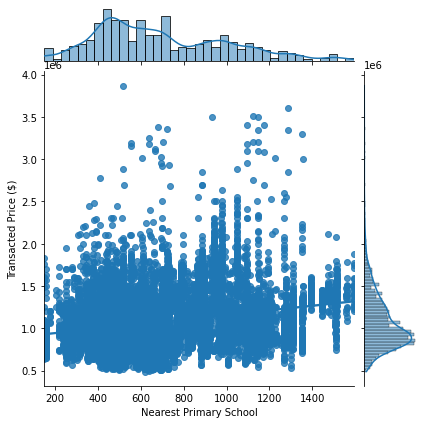

In [50]:
sns.jointplot(x="Nearest Primary School", y="Transacted Price ($)", data=east, kind = 'reg')

##### North

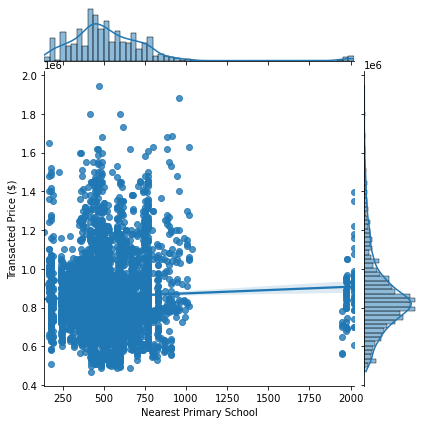

In [51]:
sns.jointplot(x="Nearest Primary School", y="Transacted Price ($)", data=north, kind = 'reg')

##### West

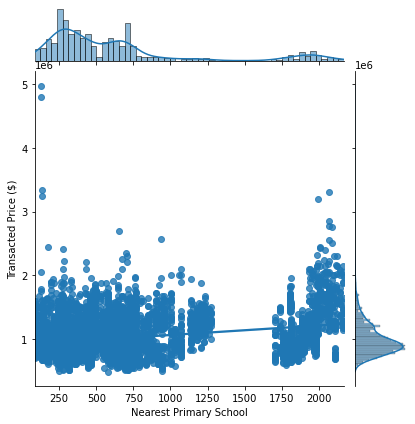

In [52]:
sns.jointplot(x="Nearest Primary School", y="Transacted Price ($)", data=west, kind = 'reg')

Conclusion: The further the nearest primary school is, the more expensive the property. Hence, hypothesis 2 is refuted. 

### Train Stations

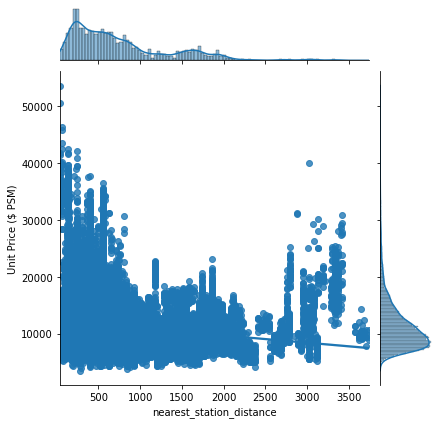

In [56]:
sns.jointplot(x="nearest_station_distance", y="Unit Price ($ PSM)", data=df, kind = 'reg')

In [ ]:
sns.jointplot(x="nearest_station_distance", y="Transacted Price ($)", data=df, kind = 'reg')

#### Conclusion: The further the nearest station is, the cheaper the property. Thus, hypothesis 3 is not rejected.

#### Plotly express used for this plot, thus need to run notebook to see output.

In [54]:
fig = px.scatter(df, x="nearest_station_distance", y="Unit Price ($ PSM)", marginal_y="violin",
           marginal_x="box", trendline="ols", template="simple_white", 
                 title = "Unit Price Per Area Against Distance To Nearest Train Station", 
                labels={
                     "nearest_station_distance": "Nearest Train Station (m)"})

fig.update_traces(marker_color='#B279A2')
fig.show()